# Track Analysis

In [106]:
import pandas as pd
df_artists=pd.read_csv('artists.csv')
df_audio_features=pd.read_csv('audio_features.csv')
df_chart_positions=pd.read_csv('chart_positions.csv')
df_tracks=pd.read_csv('tracks.csv')
df_tracks_artists_mapping=pd.read_csv('tracks_artists_mapping.csv')

In [107]:
print(df_artists.columns)
print(df_audio_features.columns)
print(df_chart_positions.columns)
print(df_tracks.columns)
print(df_tracks_artists_mapping.columns)

Index(['Unnamed: 0', 'artist_id', 'name', 'popularity', 'followers'], dtype='object')
Index(['Unnamed: 0', 'track_id', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature'],
      dtype='object')
Index(['Unnamed: 0', 'chart_week', 'list_position', 'track_id'], dtype='object')
Index(['Unnamed: 0', 'track_id', 'name', 'duration_ms', 'release_date',
       'album_type', 'explicit'],
      dtype='object')
Index(['Unnamed: 0', 'artist_id', 'track_id'], dtype='object')


In [108]:
df_chart_positions['chart_week']

0         2021-07-10
1         2003-07-19
2         2003-07-26
3         2003-08-02
4         2003-07-12
5         2003-08-09
6         2003-06-28
7         2003-07-05
8         2003-06-21
9         2003-08-16
10        2003-08-23
11        2003-08-30
12        2005-06-11
13        2005-04-30
14        2005-05-21
15        2005-05-28
16        2005-06-04
17        2005-06-25
18        2005-05-07
19        2005-05-14
20        2005-06-18
21        2005-04-16
22        2005-04-02
23        2005-04-09
24        2005-04-23
25        2005-03-12
26        2005-07-02
27        2005-03-26
28        2005-03-19
29        2005-07-09
30        2005-07-16
31        2005-03-05
32        2005-07-23
33        2005-02-26
34        2005-09-17
35        2005-07-30
36        2005-08-06
37        2005-09-24
38        2005-08-13
39        2005-09-03
40        2005-09-10
41        2005-10-01
42        2005-02-19
43        2005-08-27
44        2005-08-20
45        2005-02-12
46        2005-10-08
47        200

In [109]:
df_tracks

,Unnamed: 0,track_id,name,duration_ms,release_date,album_type,explicit
0,0,5CMVGP24paZIukljDj0iWc,Jingle Bells (with The Ken Lane Singers),156666,1945,compilation,False
1,1,25leEEaz1gIpp7o21Fqyjo,Here Comes Santa Claus (Right Down Santa Claus...,150266,1947,album,False
2,2,1dtIaSlyrLI04sqYa8nLyN,Rudolph the Red-Nosed Reindeer,186733,1947,album,False
3,3,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962,album,False
4,4,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962,album,False
5,5,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962,album,False
6,6,5ASM6Qjiav2xPe7gRkQMsQ,Sleigh Ride,181266,1963,compilation,False
7,7,46pF1zFimM582ss1PrMy68,Christmas (Baby Please Come Home),166453,1963,compilation,False
8,8,7uyivkbdc8iH8wyBGBhlXV,One More Chance,229000,1979,compilation,False
9,9,2uX5f3x2cObov0iDAPln4o,Song of the South,190800,1980,album,False


In [110]:
df_tracks.loc[df_tracks.name=='BTS']

,Unnamed: 0,track_id,name,duration_ms,release_date,album_type,explicit


In [111]:
df_chart_positions.sample(10)

,Unnamed: 0,chart_week,list_position,track_id
96202,96202,2020-01-11,58,5qdQPrWmZv8xYhMJCDrdHF
83869,83869,2011-07-16,17,54QbmsN1P8JKzJlKfEVPLe
102900,102900,2018-11-24,4,6FZDfxM3a3UCqtzo5pxSLZ
103595,103595,2007-04-07,89,6I5xABsVToEjk9kssq8B1k
23598,23598,2016-07-02,62,1N7qGCKRRnvjoy8MGyHgpS
40485,40485,2001-01-27,27,2Pxzfzd1jaZT2F2uqLkZUr
124949,124949,2002-06-08,4,7lQ8MOhq6IN2w8EYcFNSUk
53118,53118,2015-12-12,57,3CRDbSIZ4r5MsZ0YwxuEkn
110865,110865,2010-05-01,95,6i81qFkru6Kj1IEsB7KNp2
14622,14622,2019-05-11,75,0pGXe7umwkcCm01Ipoxp0U


In [112]:
df_chart_positions.shape

(129305, 4)

In [113]:
df_chart_positions['chart_week'].nunique()

1294

# Data Preprocessing

In [114]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



# Remove the 'Unnamed: 0' columns
dfs = [df_artists, df_audio_features, df_chart_positions, df_tracks, df_tracks_artists_mapping]
for df in dfs:
    if 'Unnamed: 0' in df.columns:
        df.drop(columns=['Unnamed: 0'], inplace=True)

# Convert date columns to datetime format
df_chart_positions['chart_week'] = pd.to_datetime(df_chart_positions['chart_week'], errors='coerce')
df_tracks['release_date'] = pd.to_datetime(df_tracks['release_date'], errors='coerce')


In [115]:
# Filter chart weeks for 2020 and later
df_chart_positions = df_chart_positions[df_chart_positions['chart_week'] >= '2020-01-01']

# Display the first few rows of the filtered dataframe
print(df_chart_positions.head())

   chart_week  list_position                track_id
0  2021-07-10             42  000TJlEJQ3nafsm1hBWpoj
96 2021-11-20              6  00Blm7zeNqgYLPtW6zg8cj
97 2022-05-07             17  00Blm7zeNqgYLPtW6zg8cj
98 2022-04-09             19  00Blm7zeNqgYLPtW6zg8cj
99 2022-04-16             19  00Blm7zeNqgYLPtW6zg8cj


In [116]:
df_chart_positions.sort_values(by='list_position')

,chart_week,list_position,track_id
83453,2022-02-19,1,52xJxFP6TqMuO4Yt0eOkMz
119363,2023-03-04,1,7DSAEUvxU8FajXtRloy8M0
71273,2024-04-27,1,4IadxL6BUymXlh8RCJJu7T
119362,2023-02-25,1,7DSAEUvxU8FajXtRloy8M0
37786,2024-01-06,1,2EjXfH91m7f8HiJN1yQg97
56220,2023-04-29,1,3OHfY25tqY28d16oZczHc8
37785,2023-12-16,1,2EjXfH91m7f8HiJN1yQg97
119364,2023-03-25,1,7DSAEUvxU8FajXtRloy8M0
37784,2023-12-09,1,2EjXfH91m7f8HiJN1yQg97
119361,2023-02-18,1,7DSAEUvxU8FajXtRloy8M0


In [117]:
df_tracks

,track_id,name,duration_ms,release_date,album_type,explicit
0,5CMVGP24paZIukljDj0iWc,Jingle Bells (with The Ken Lane Singers),156666,1945-01-01,compilation,False
1,25leEEaz1gIpp7o21Fqyjo,Here Comes Santa Claus (Right Down Santa Claus...,150266,1947-01-01,album,False
2,1dtIaSlyrLI04sqYa8nLyN,Rudolph the Red-Nosed Reindeer,186733,1947-01-01,album,False
3,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962-01-01,album,False
4,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962-01-01,album,False
5,4PS1e8f2LvuTFgUs1Cn3ON,The Christmas Song (Merry Christmas To You),192160,1962-01-01,album,False
6,5ASM6Qjiav2xPe7gRkQMsQ,Sleigh Ride,181266,1963-01-01,compilation,False
7,46pF1zFimM582ss1PrMy68,Christmas (Baby Please Come Home),166453,1963-01-01,compilation,False
8,7uyivkbdc8iH8wyBGBhlXV,One More Chance,229000,1979-01-01,compilation,False
9,2uX5f3x2cObov0iDAPln4o,Song of the South,190800,1980-01-01,album,False


In [118]:
# Merge datasets to associate artists with chart positions
artist_chart_data = (
    df_chart_positions
    .merge(df_tracks_artists_mapping, on='track_id')
    .merge(df_artists, on='artist_id')
)

# Group by artist and calculate chart statistics
artist_performance = (
    artist_chart_data
    .groupby('name')  # Artist name
    .agg(
        total_chart_appearances=('list_position', 'count'),
        avg_chart_position=('list_position', 'mean')
    )
    .sort_values(by='total_chart_appearances', ascending=False)
)

print(artist_performance.head(10))


               total_chart_appearances  avg_chart_position
name                                                      
Drake                              946           44.276956
Morgan Wallen                      899           47.671858
Taylor Swift                       741           44.331984
Lil Baby                           709           56.279267
Bad Bunny                          589           56.896435
Doja Cat                           530           34.337736
The Weeknd                         514           30.529183
21 Savage                          474           48.272152
Future                             462           50.264069
SZA                                455           40.740659


In [119]:
df1=artist_chart_data.groupby('name').agg(total_chart_appearances=('list_position', 'count'), avg_chart_position=('list_position', 'mean')).sort_values(by='total_chart_appearances', ascending=False)

In [120]:
df1

,total_chart_appearances,avg_chart_position
name,,
Drake,946,44.276956
Morgan Wallen,899,47.671858
Taylor Swift,741,44.331984
Lil Baby,709,56.279267
Bad Bunny,589,56.896435
Doja Cat,530,34.337736
The Weeknd,514,30.529183
21 Savage,474,48.272152
Future,462,50.264069


In [121]:
df2=artist_chart_data.groupby('name').agg(total_chart_appearances=('list_position', 'count'), avg_chart_position=('list_position', 'mean')).sort_values(by='avg_chart_position', ascending=False)
df2.head(100)

,total_chart_appearances,avg_chart_position
name,,
ThxSoMch,1,100.000000
Carlos Vives,1,100.000000
Skillibeng,1,100.000000
Lyanno,1,99.000000
Yak Gotti,1,99.000000
Lil Duke,1,99.000000
Byron Messia,1,99.000000
Tears For Fears,1,99.000000
DAISY WORLD,1,99.000000


In [122]:
unique_artist_names = artist_chart_data[artist_chart_data.popularity > 80].sort_values(by='popularity', ascending=False)['name'].unique()



# 1. Dominant Artists by Popularity

In [123]:
sorted_artists = artist_chart_data.sort_values(by='popularity', ascending=False)[['name', 'popularity']]
unique_sorted_artists = sorted_artists.drop_duplicates(subset='name')
# Set the display options to show more rows
pd.set_option('display.max_rows', None)  # This will allow displaying all rows
pd.set_option('display.max_columns', None) 
unique_sorted_artists.reset_index().head(100)

,index,name,popularity
0,8806,Taylor Swift,100
1,8030,Drake,96
2,8237,Billie Eilish,96
3,639,The Weeknd,96
4,3767,Bad Bunny,95
5,6893,Sabrina Carpenter,95
6,5807,Bruno Mars,94
7,9490,Travis Scott,94
8,4487,Future,93
9,14880,Eminem,93


BTS (87) - South Korean.
Jung Kook(87)
Jimin (89) - South Korean, part of BTS.
Stray Kids (85) - South Korean group.


In [124]:
bts_data=artist_chart_data.loc[artist_chart_data.name=='BTS']
bts_data

,chart_week,list_position,track_id,artist_id,name,popularity,followers
19884,2020-03-07,84,0YJFlxeHMUr9MxSDQVuQJA,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19885,2020-03-07,4,0fZRNhPJ4AGmwY7rkpdbqK,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19886,2020-03-14,68,0fZRNhPJ4AGmwY7rkpdbqK,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19887,2020-12-05,72,0hxeouHqP3qzpTHerA7ha2,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19888,2022-08-20,10,0xzI1KAr0Yd9tv8jlIk3sn,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19889,2022-08-27,57,0xzI1KAr0Yd9tv8jlIk3sn,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19890,2022-09-03,60,0xzI1KAr0Yd9tv8jlIk3sn,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19891,2022-09-10,89,0xzI1KAr0Yd9tv8jlIk3sn,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19892,2022-09-17,90,0xzI1KAr0Yd9tv8jlIk3sn,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19893,2022-06-25,13,10SRMwb9EuVS1K9rYsBfHQ,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947


In [125]:
bts_data.sort_values('list_position').head(5)

,chart_week,list_position,track_id,artist_id,name,popularity,followers
19901,2021-07-10,1,1mWdTewIgB3gtBM3TOSFhB,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19905,2021-09-11,1,1mWdTewIgB3gtBM3TOSFhB,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19904,2021-08-07,1,1mWdTewIgB3gtBM3TOSFhB,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19903,2021-07-31,1,1mWdTewIgB3gtBM3TOSFhB,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947
19902,2021-07-17,1,1mWdTewIgB3gtBM3TOSFhB,3Nrfpe0tUJi4K4DXYWgMUX,BTS,87,76212947


In [126]:
bts_data = df1[df1.index == 'BTS']

print(bts_data)

      total_chart_appearances  avg_chart_position
name                                             
BTS                        98           32.489796


In [127]:
dfbts=df1.loc['BTS',:]
dfbts

total_chart_appearances    98.000000
avg_chart_position         32.489796
Name: BTS, dtype: float64

In [128]:
df_artists

,artist_id,name,popularity,followers
0,13UwRaADQI0yTqjPBDkk6d,J-Shin (Featuring LaTocha Scott of Xscape),0,253
1,2LmsYeN3MzzZ9zhuZhNyqO,A*Teens,0,10
2,5Q25oFANw7zA3kD2DPaJ8D,The 2000s Karaoke Band,0,26
3,7u7ORV6MVjId1jfJwMdakL,2000s Karaoke Band,0,27
4,0LyfQWJT6nXafLPZqxe9Of,Various Artists,0,2542450
5,0sghswo09Y90G2q0eha4SW,Joe Osborne,0,23
6,14qvHyl1HApvsMrtxXljMM,Archuleta Maroon,0,21
7,1b9wvEcR1vuxoVu6isElSd,Anand Clique,0,109
8,5lfsewMdyn5f9okNcLUtYM,Xander Phillips,0,79
9,0o9FGMZT1bOTSGYFb7BoWz,Drop That Thun Thun,0,250


# 2. Comparison of Asia Artists

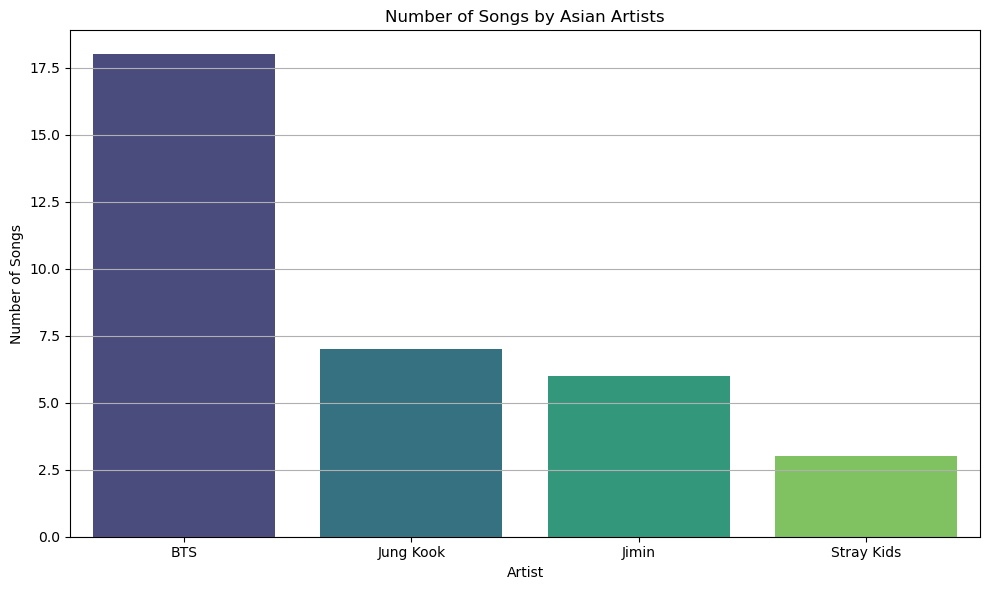

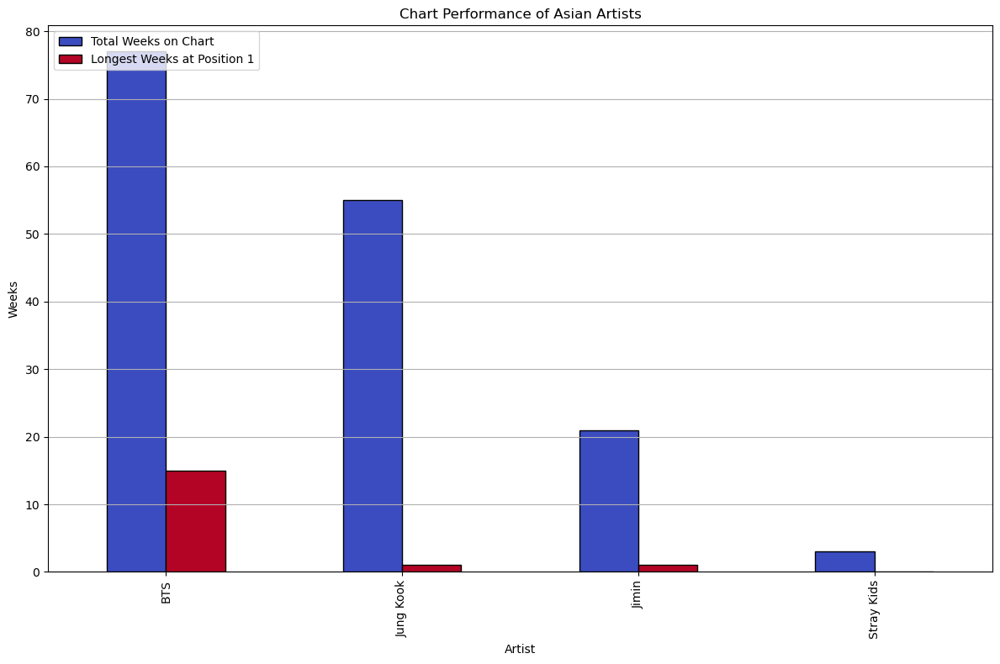

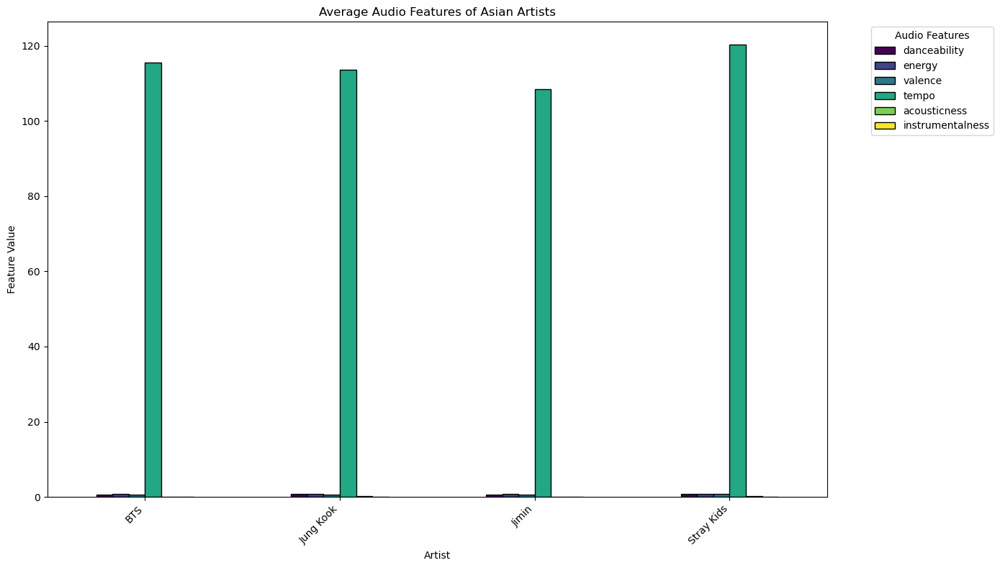

In [129]:
# Step 1: Filter data for Asian artists
asian_artists = ['BTS', 'Jung Kook', 'Jimin', 'Stray Kids']
asian_artist_data = artist_chart_data[artist_chart_data['name'].isin(asian_artists)]
audio_features = ['danceability', 'energy', 'valence', 'tempo', 'acousticness', 'instrumentalness']

# Step 2: Group by artist and calculate metrics
metrics = []

for artist in asian_artists:
    # Filter data for the artist
    artist_data = asian_artist_data[asian_artist_data['name'] == artist]
    
    # Number of songs
    num_songs = artist_data['track_id'].nunique()
    
    # Total weeks at chart positions
    total_weeks = artist_data['chart_week'].nunique()
    
    # Longest weeks at position 1
    longest_weeks_at_1 = artist_data[artist_data['list_position'] == 1]['chart_week'].nunique()
    
    # Average audio features
    artist_features = df_audio_features[df_audio_features['track_id'].isin(artist_data['track_id'])]
    avg_features = artist_features[audio_features].mean()
    
    # Combine metrics
    metrics.append({
        'artist': artist,
        'num_songs': num_songs,
        'total_weeks': total_weeks,
        'longest_weeks_at_1': longest_weeks_at_1,
        **avg_features
    })

# Convert metrics to a DataFrame
metrics_df = pd.DataFrame(metrics)

# Step 3: Visualization - Number of Songs and Chart Performance
# Bar chart for number of songs
plt.figure(figsize=(10, 6))
sns.barplot(data=metrics_df, x='artist', y='num_songs', palette='viridis')
plt.title("Number of Songs by Asian Artists")
plt.xlabel("Artist")
plt.ylabel("Number of Songs")
plt.grid(axis='y')
plt.tight_layout()
plt.show()

# Bar chart for total weeks and longest weeks at position 1
metrics_df[['artist', 'total_weeks', 'longest_weeks_at_1']].set_index('artist').plot(
    kind='bar', figsize=(12, 8), colormap='coolwarm', edgecolor='black'
)
plt.title("Chart Performance of Asian Artists")
plt.xlabel("Artist")
plt.ylabel("Weeks")
plt.legend(["Total Weeks on Chart", "Longest Weeks at Position 1"], loc='upper left')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

# Step 4: Visualization - Audio Features
# Bar chart for audio features
metrics_df.set_index('artist')[audio_features].plot(
    kind='bar', figsize=(14, 8), colormap='viridis', edgecolor='black'
)
plt.title("Average Audio Features of Asian Artists")
plt.xlabel("Artist")
plt.ylabel("Feature Value")
plt.legend(title="Audio Features", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()




# 3 Deep Analysis of Asia Artists: BTS(BTS Notable Charting Song)

In [130]:
# Step 1: Get the artist_id for BTS
bts_artist = df_artists.loc[df_artists['name'] == 'BTS']
bts_id = bts_artist['artist_id'].iloc[0]

# Step 2: Get tracks by BTS
bts_tracks_mapping = df_tracks_artists_mapping.loc[df_tracks_artists_mapping['artist_id'] == bts_id]
bts_track_ids = bts_tracks_mapping['track_id'].unique()

# Step 3: Merge data for detailed analysis
bts_tracks = df_tracks.loc[df_tracks['track_id'].isin(bts_track_ids)]
bts_audio_features = df_audio_features.loc[df_audio_features['track_id'].isin(bts_track_ids)]
bts_chart_positions = df_chart_positions.loc[df_chart_positions['track_id'].isin(bts_track_ids)]

# Merge all data
bts_data = bts_tracks.merge(bts_audio_features, on='track_id', how='left')
bts_data = bts_data.merge(bts_chart_positions, on='track_id', how='left')

In [131]:
bts_data

,track_id,name,duration_ms,release_date,album_type,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,chart_week,list_position
0,6XxpvCj3eLWs3lYowSgC4G,MIC Drop (feat. Desiigner) [Steve Aoki Remix],238726,NaT,single,False,0.612,0.841,10.0,-4.332,0.0,0.2190,0.01570,0.000000,0.2300,0.644,169.915,4.0,NaT,NaN
1,6m1TWFMeon7ai9XLOzdbiR,FAKE LOVE,242333,NaT,album,False,0.557,0.719,2.0,-4.515,0.0,0.0371,0.00267,0.000000,0.3060,0.345,77.502,4.0,NaT,NaN
2,2ngmiq1KoYn3x25VOmvd8F,DNA,223122,NaT,album,False,0.599,0.775,1.0,-3.997,0.0,0.0542,0.02200,0.000000,0.0669,0.703,129.817,4.0,NaT,NaN
3,54azQnjuDYDFfImXimGFsA,IDOL,260233,NaT,album,False,0.708,0.857,6.0,-3.394,0.0,0.0827,0.00219,0.000000,0.1030,0.449,126.051,4.0,NaT,NaN
4,2J0X46UkpfLlWbuCXFgDLr,Waste It On Me (feat. BTS),192536,NaT,album,False,0.669,0.684,7.0,-4.595,1.0,0.0585,0.25200,0.000000,0.7200,0.466,96.097,4.0,NaT,NaN
5,4a9tbd947vo9K8Vti9JwcI,Boy With Luv (feat. Halsey),229773,NaT,album,False,0.645,0.862,11.0,-4.761,0.0,0.0845,0.09330,0.000000,0.1930,0.803,119.947,4.0,NaT,NaN
6,2WH4oy1SYppZrcdgKwSA0j,Make It Right (feat. Lauv),226321,NaT,single,False,0.583,0.680,7.0,-7.809,1.0,0.4220,0.03040,0.000000,0.1890,0.343,97.568,4.0,NaT,NaN
7,6wH3AP7b01vpzKYRJhreMy,Black Swan,198260,NaT,single,False,0.719,0.757,2.0,-5.167,0.0,0.0849,0.13700,0.000000,0.1290,0.489,147.024,4.0,2020-02-01,57.0
8,0fZRNhPJ4AGmwY7rkpdbqK,ON,246380,NaT,album,False,0.583,0.817,9.0,-5.146,0.0,0.0990,0.11800,0.000000,0.3380,0.437,105.935,4.0,2020-03-07,4.0
9,0fZRNhPJ4AGmwY7rkpdbqK,ON,246380,NaT,album,False,0.583,0.817,9.0,-5.146,0.0,0.0990,0.11800,0.000000,0.3380,0.437,105.935,4.0,2020-03-14,68.0


In [132]:
# Convert duration_ms to minutes
bts_data['duration_minutes'] = bts_data['duration_ms'] / 60000



In [133]:
bts_data[['name', 'duration_ms','duration_minutes','list_position']].dropna().sort_values('list_position').drop_duplicates()

,name,duration_ms,duration_minutes,list_position
55,Butter,164441,2.740683,1.0
44,Life Goes On,207481,3.458017,1.0
71,Permission to Dance,187585,3.126417,1.0
12,Dynamite,199053,3.317550,1.0
15,Dynamite,199053,3.317550,2.0
19,Dynamite,199053,3.317550,3.0
8,ON,246380,4.106333,4.0
61,Butter,164441,2.740683,4.0
21,Dynamite,199053,3.317550,5.0
62,Butter,164441,2.740683,7.0


In [134]:
bts_data.name.unique()

array(['MIC Drop (feat. Desiigner) [Steve Aoki Remix]', 'FAKE LOVE',
       'DNA', 'IDOL', 'Waste It On Me (feat. BTS)',
       'Boy With Luv (feat. Halsey)', 'Make It Right (feat. Lauv)',
       'Black Swan', 'ON', 'My Time', 'Filter', 'Dynamite',
       'Life Goes On', 'Fly To My Room', 'Telepathy', 'Dis-ease',
       'Film out', 'Butter', 'Permission to Dance', 'Yet To Come',
       'Run BTS', 'Bad Decisions (with BTS & Snoop Dogg)',
       'Left and Right (Feat. Jung Kook of BTS)', 'Take Two',
       'Girl Of My Dreams (with SUGA of BTS)'], dtype=object)

# Top list Position of Tracks and how long chart week

In [135]:
# Step 3: Filter chart data for BTS tracks at list_position 1: ##filter trackid of bts in chart position 
bts_chart_data = df_chart_positions[
    (df_chart_positions['track_id'].isin(bts_track_ids)) & (df_chart_positions['list_position'] == 1)
]

# Step 4: Merge with track names for readability
bts_chart_data = bts_chart_data.merge(df_tracks[['track_id', 'name']], on='track_id', how='left')

# Step 5: Count the number of chart weeks at position 1 for each track
bts_top_chart_tracks = (
    bts_chart_data.groupby('name')['chart_week']
    .nunique()
    .reset_index()
    .rename(columns={'chart_week': 'weeks_at_position_1'})
    .sort_values(by='weeks_at_position_1', ascending=False)
)

# Step 6: Display results
print(bts_top_chart_tracks)



                  name  weeks_at_position_1
0               Butter                   10
1             Dynamite                    3
2         Life Goes On                    1
3  Permission to Dance                    1


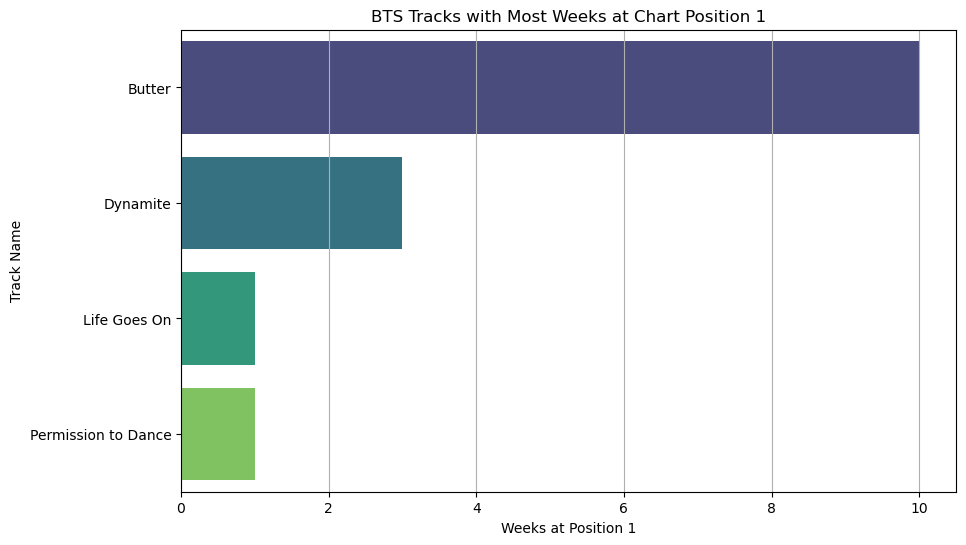

In [136]:
# Plot chart performance
plt.figure(figsize=(10, 6))
sns.barplot(data=bts_top_chart_tracks, x='weeks_at_position_1', y='name', palette='viridis')
plt.title("BTS Tracks with Most Weeks at Chart Position 1")
plt.xlabel("Weeks at Position 1")
plt.ylabel("Track Name")
plt.grid(axis='x')
plt.show()

# Audio Features of TOp Tracks

In [137]:
# Step 1: Identify top tracks
top_tracks = bts_top_chart_tracks['name'].tolist()
top_tracks

['Butter', 'Dynamite', 'Life Goes On', 'Permission to Dance']

In [138]:
bts_audio_features

,track_id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
606,2WH4oy1SYppZrcdgKwSA0j,0.583,0.680,7.0,-7.809,1.0,0.4220,0.03040,0.000000,0.1890,0.343,97.568,4.0
611,0fZRNhPJ4AGmwY7rkpdbqK,0.583,0.817,9.0,-5.146,0.0,0.0990,0.11800,0.000000,0.3380,0.437,105.935,4.0
631,54azQnjuDYDFfImXimGFsA,0.708,0.857,6.0,-3.394,0.0,0.0827,0.00219,0.000000,0.1030,0.449,126.051,4.0
733,3XYRV7ZSHqIRDG87DKTtry,0.702,0.741,9.0,-5.330,1.0,0.0427,0.00544,0.000000,0.3370,0.646,124.925,4.0
971,10SRMwb9EuVS1K9rYsBfHQ,0.559,0.885,1.0,-4.515,1.0,0.1890,0.04320,0.000000,0.3330,0.683,172.029,4.0
1494,4bZZVcgWWMWPBwzTTp642w,0.779,0.762,10.0,-5.188,0.0,0.0631,0.02240,0.000000,0.1210,0.859,110.043,4.0
2032,6XxpvCj3eLWs3lYowSgC4G,0.612,0.841,10.0,-4.332,0.0,0.2190,0.01570,0.000000,0.2300,0.644,169.915,4.0
2118,0hxeouHqP3qzpTHerA7ha2,0.731,0.845,8.0,-5.352,1.0,0.1320,0.01320,0.000000,0.0782,0.484,101.085,4.0
2261,6wH3AP7b01vpzKYRJhreMy,0.719,0.757,2.0,-5.167,0.0,0.0849,0.13700,0.000000,0.1290,0.489,147.024,4.0
3558,3UHPGOkUcE4hE7sqBF4Snt,0.499,0.709,10.0,-6.404,1.0,0.1340,0.29600,0.000000,0.3310,0.314,164.032,4.0


featuredanceability
name
Butter                 0.759
Dynamite               0.746
Life Goes On           0.566
Permission to Dance    0.702
Name: danceability, dtype: float64


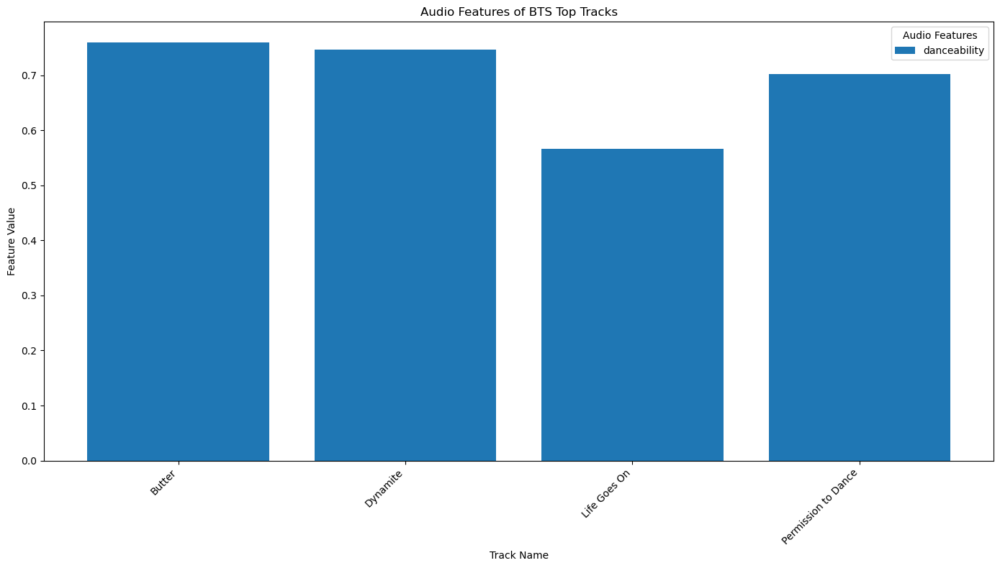

featureenergy
name
Butter                 0.459
Dynamite               0.765
Life Goes On           0.716
Permission to Dance    0.741
Name: energy, dtype: float64


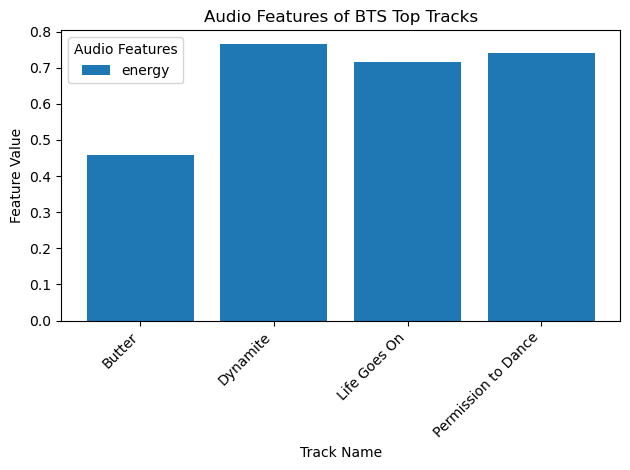

featurevalence
name
Butter                 0.695
Dynamite               0.737
Life Goes On           0.450
Permission to Dance    0.646
Name: valence, dtype: float64


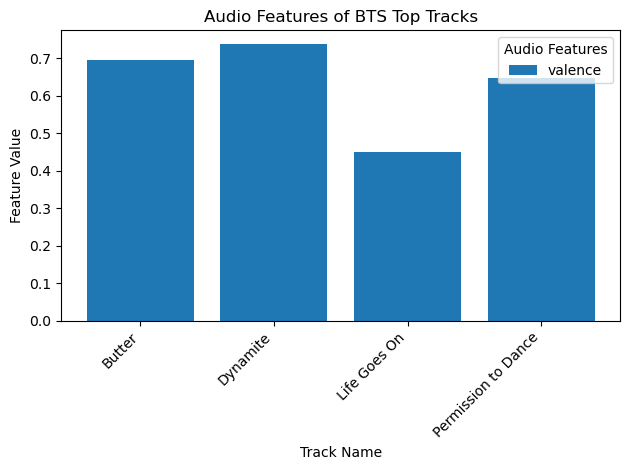

featuretempo
name
Butter                 109.997
Dynamite               114.044
Life Goes On            81.068
Permission to Dance    124.925
Name: tempo, dtype: float64


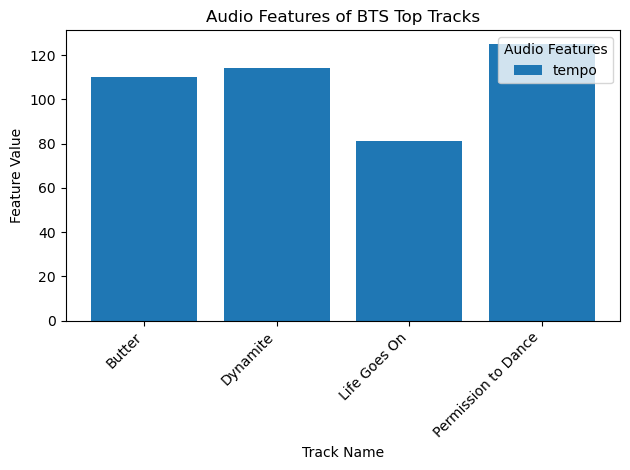

featureacousticness
name
Butter                 0.00323
Dynamite               0.01120
Life Goes On           0.00691
Permission to Dance    0.00544
Name: acousticness, dtype: float64


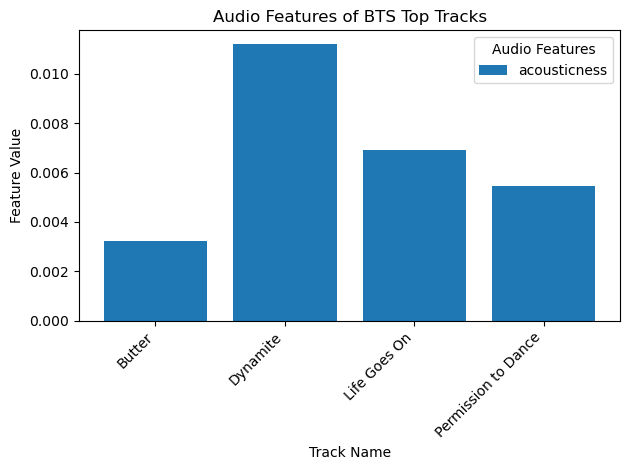

featureinstrumentalness
name
Butter                 0.0
Dynamite               0.0
Life Goes On           0.0
Permission to Dance    0.0
Name: instrumentalness, dtype: float64


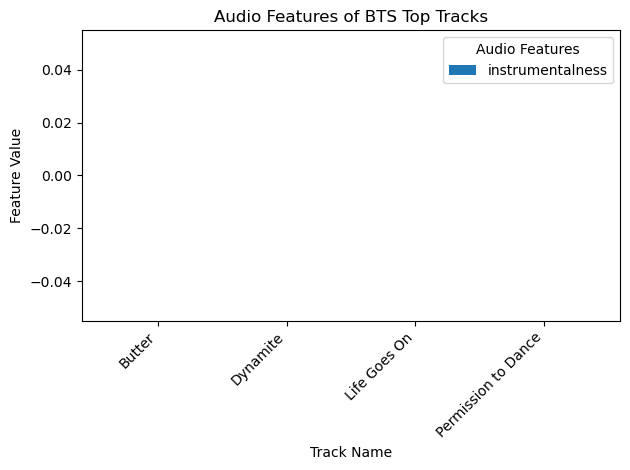

In [139]:
# Step 1: Identify top tracks
top_tracks = bts_top_chart_tracks['name'].tolist()

# Step 2: Extract audio features for top tracks
top_tracks_features = bts_data[bts_data['name'].isin(top_tracks)]

# Step 3: Plot audio feature comparison for top tracks
audio_features = ['danceability', 'energy', 'valence', 'tempo', 'acousticness', 'instrumentalness']
plt.figure(figsize=(14, 8))

# Use a bar plot to compare audio features
for feature in audio_features:
    feature_means = top_tracks_features.groupby('name')[feature].mean()
    print(f'feature{feature}')
    print(feature_means)
    plt.bar(feature_means.index, feature_means.values, label=feature)

    plt.title("Audio Features of BTS Top Tracks")
    plt.xlabel("Track Name")
    plt.ylabel("Feature Value")
    plt.legend(title="Audio Features")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()




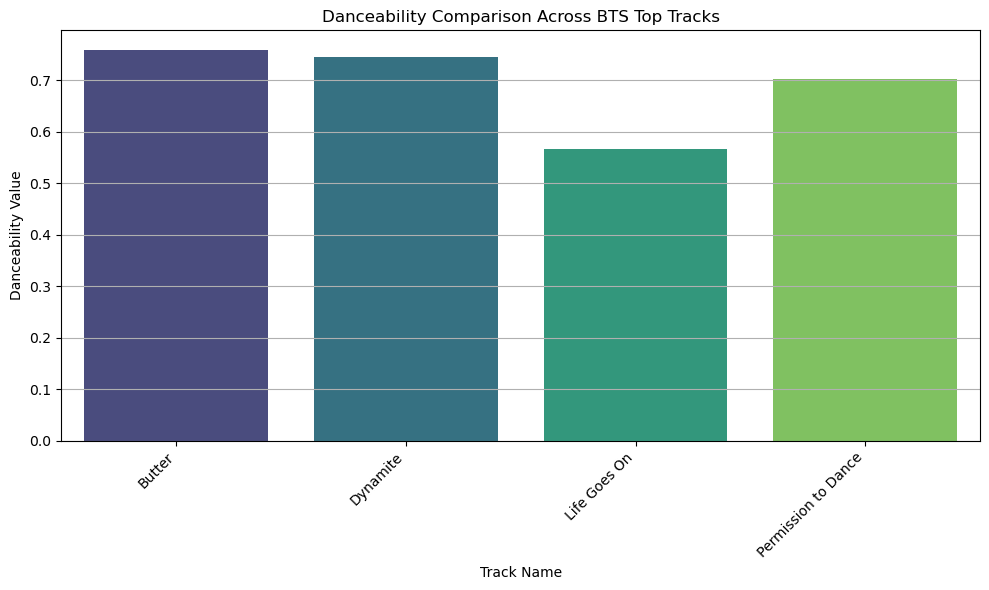

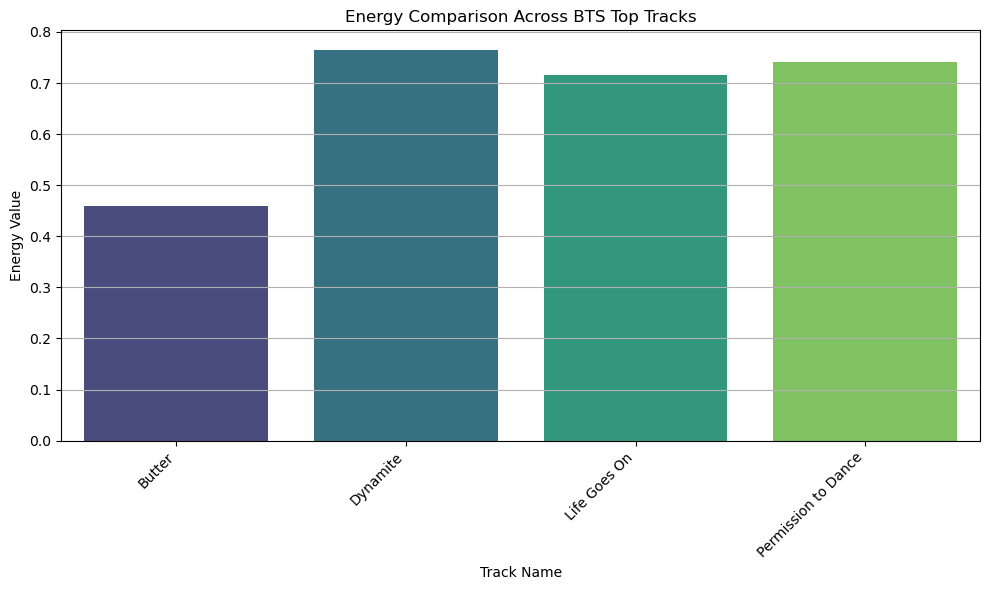

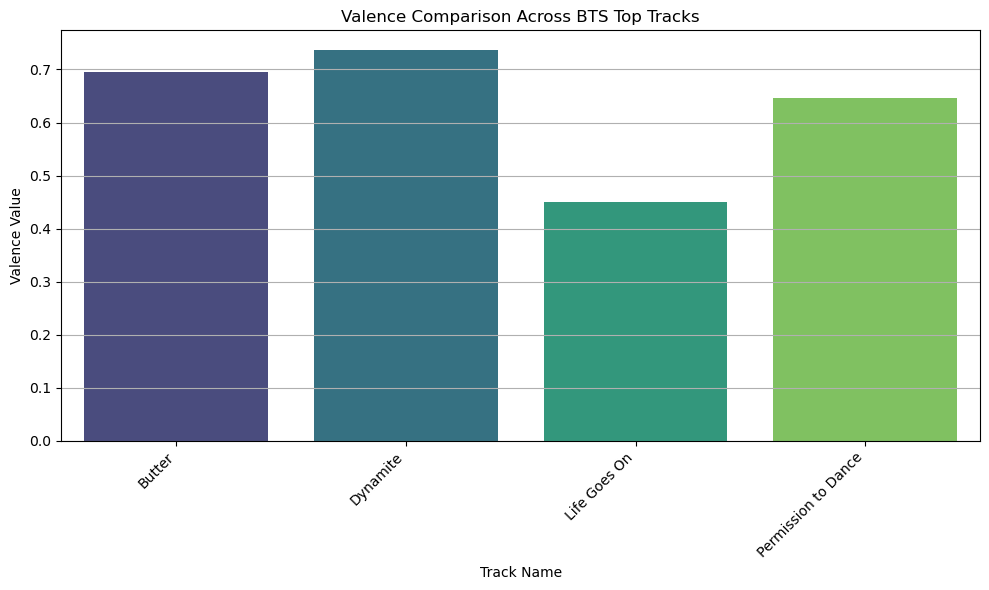

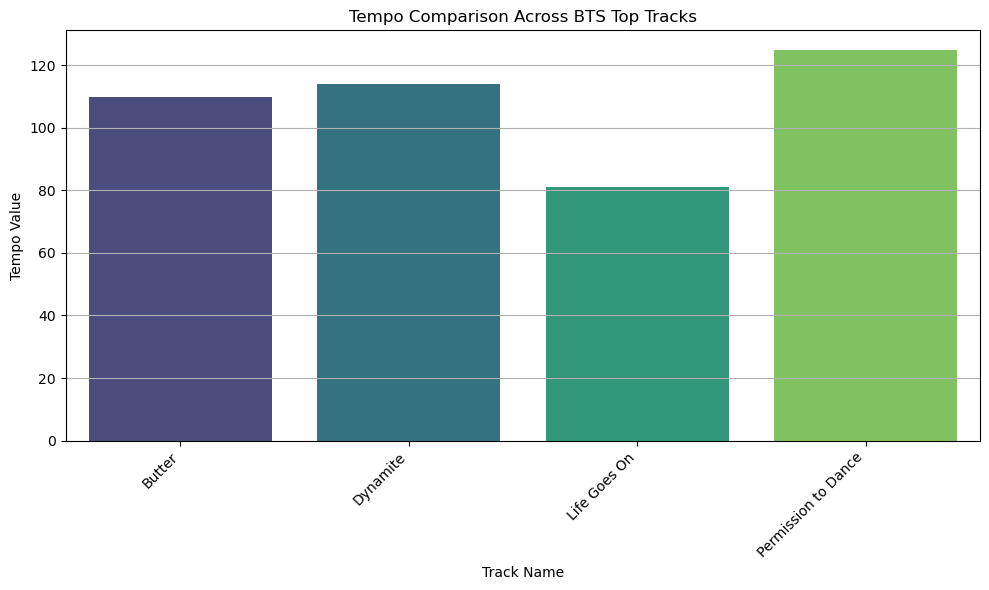

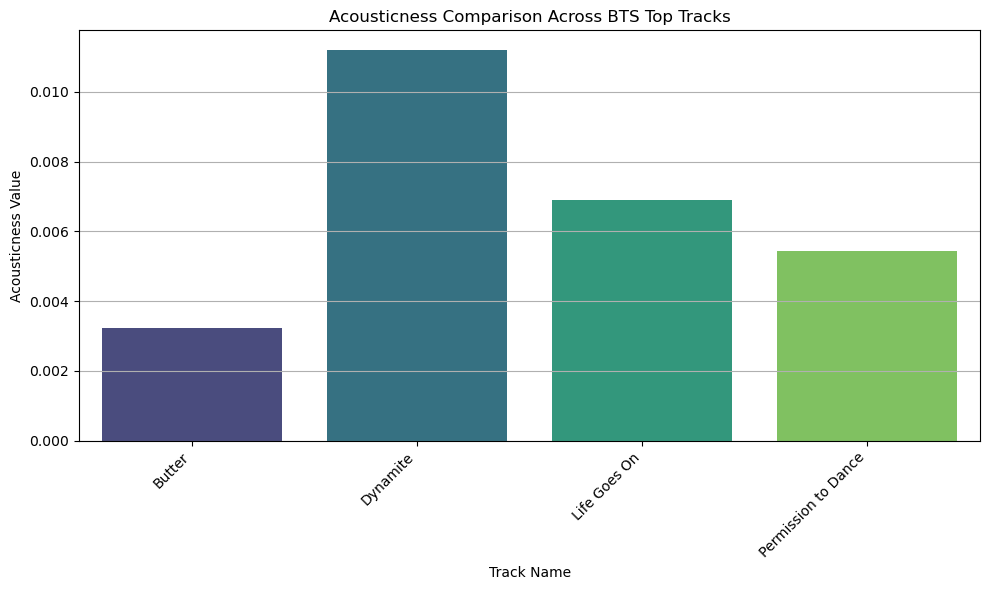

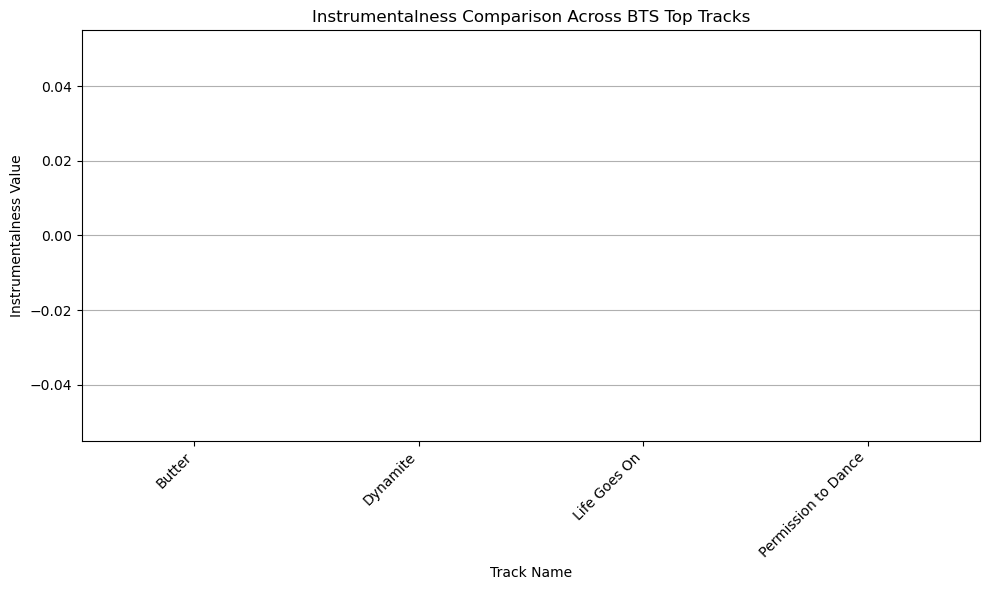

In [140]:
# Step 1: Individual bar charts for each audio feature
for feature in audio_features:
    feature_means = top_tracks_features.groupby('name')[feature].mean()
    
    # Plotting each feature as a bar chart
    plt.figure(figsize=(10, 6))
    sns.barplot(x=feature_means.index, y=feature_means.values, palette='viridis')
    plt.title(f"{feature.capitalize()} Comparison Across BTS Top Tracks")
    plt.xlabel("Track Name")
    plt.ylabel(f"{feature.capitalize()} Value")
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()


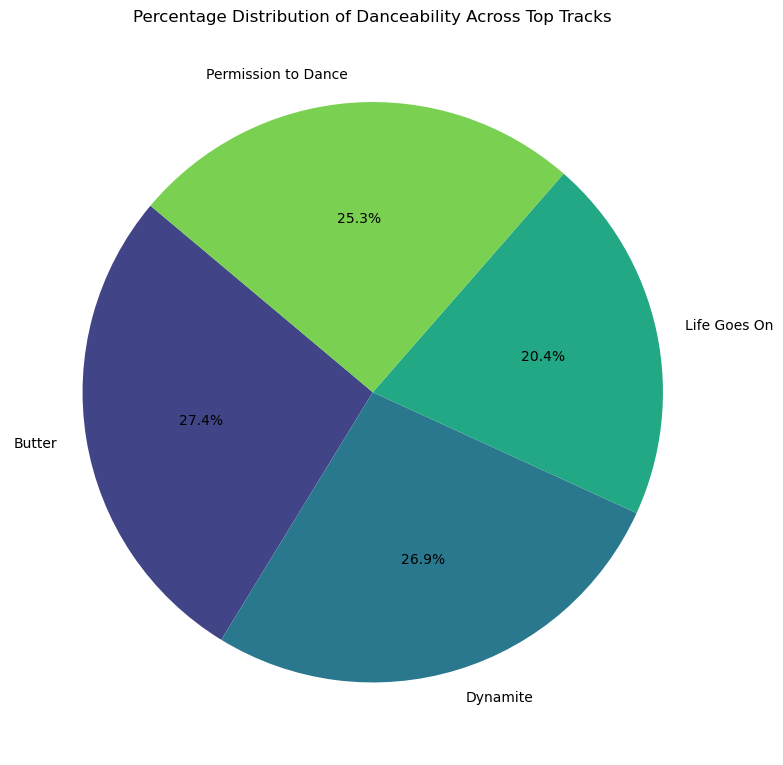

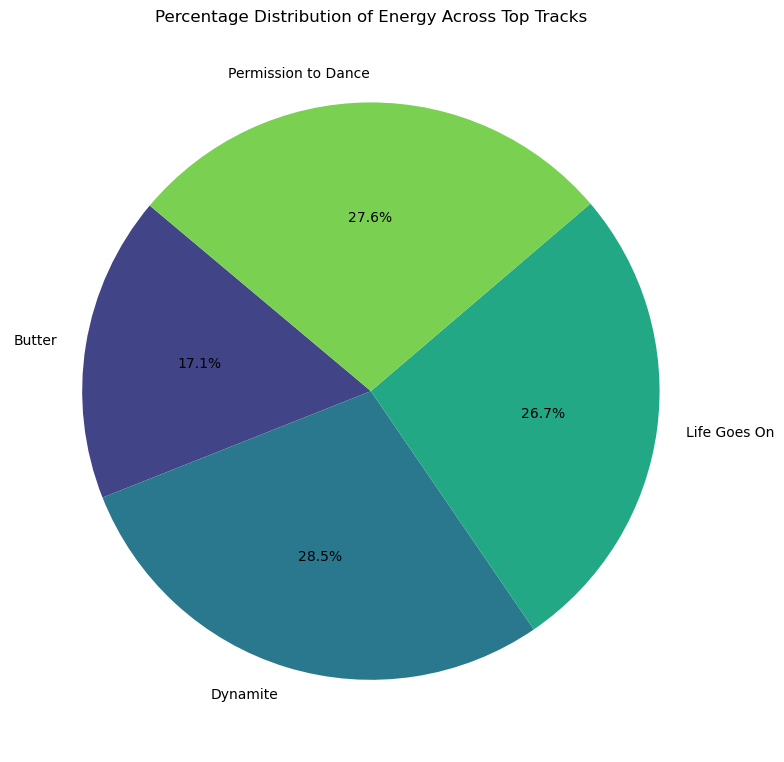

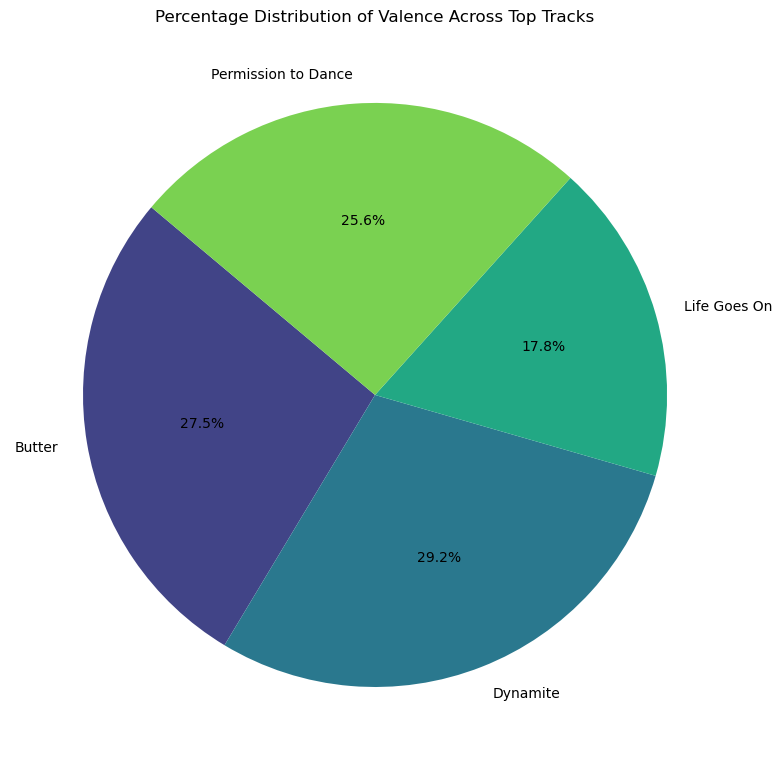

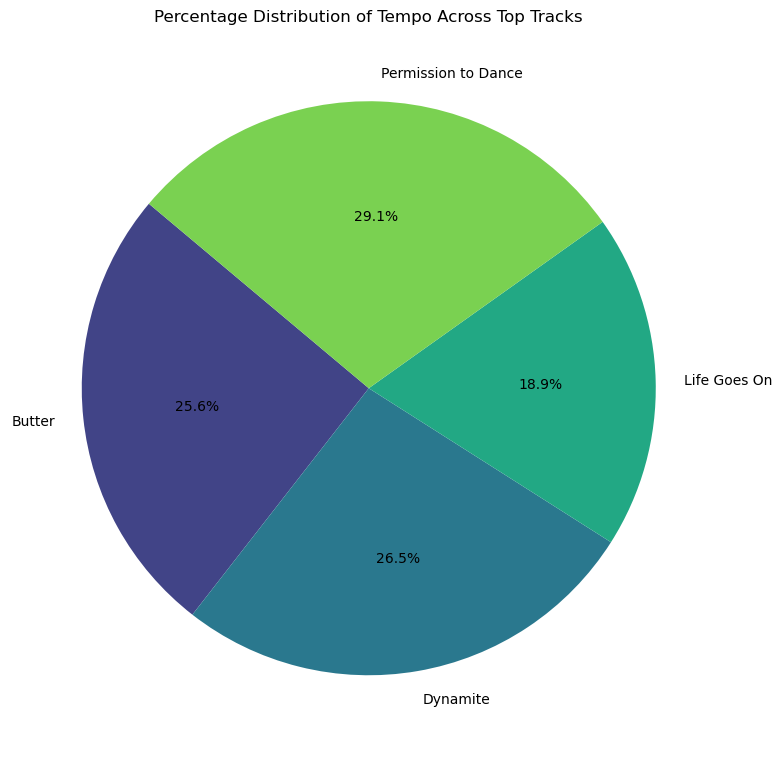

In [143]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure audio_features is a list of valid column names
audio_features = ['danceability', 'energy', 'valence', 'tempo']  # Example feature list

# Pie charts for each feature
for feature in audio_features:
    if feature not in top_tracks_features.columns:
        print(f"Feature '{feature}' not found in the dataset. Skipping.")
        continue
    
    # Group by 'name' and calculate mean for the feature
    feature_means = top_tracks_features.groupby('name')[feature].mean()
    
    if feature_means.empty:
        print(f"No data available for feature '{feature}'. Skipping.")
        continue

    # Calculate percentages
    total = feature_means.sum()
    if total == 0:
        print(f"Total for feature '{feature}' is zero. Skipping.")
        continue

    percentages = (feature_means / total) * 100  # Convert to percentage
    
    # Plot the pie chart
    plt.figure(figsize=(8, 8))
    plt.pie(
        percentages.values,
        labels=percentages.index,
        autopct='%1.1f%%',
        startangle=140,
        colors=sns.color_palette('viridis', len(percentages))
    )
    plt.title(f"Percentage Distribution of {feature.capitalize()} Across Top Tracks")
    plt.tight_layout()
    plt.show()


In [ ]:
feature_means

<Figure size 1200x800 with 0 Axes>

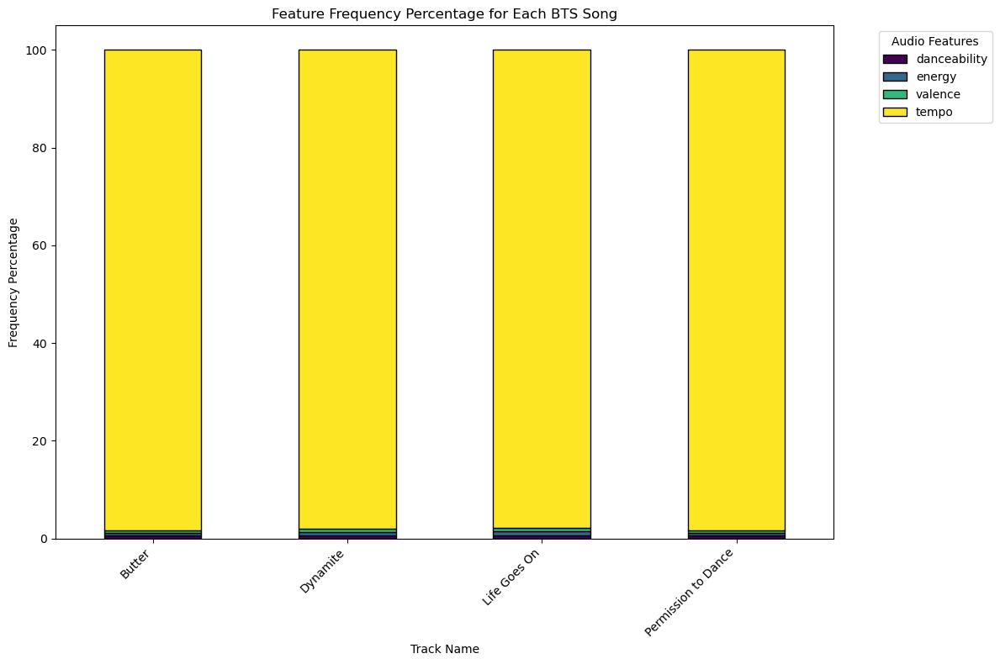

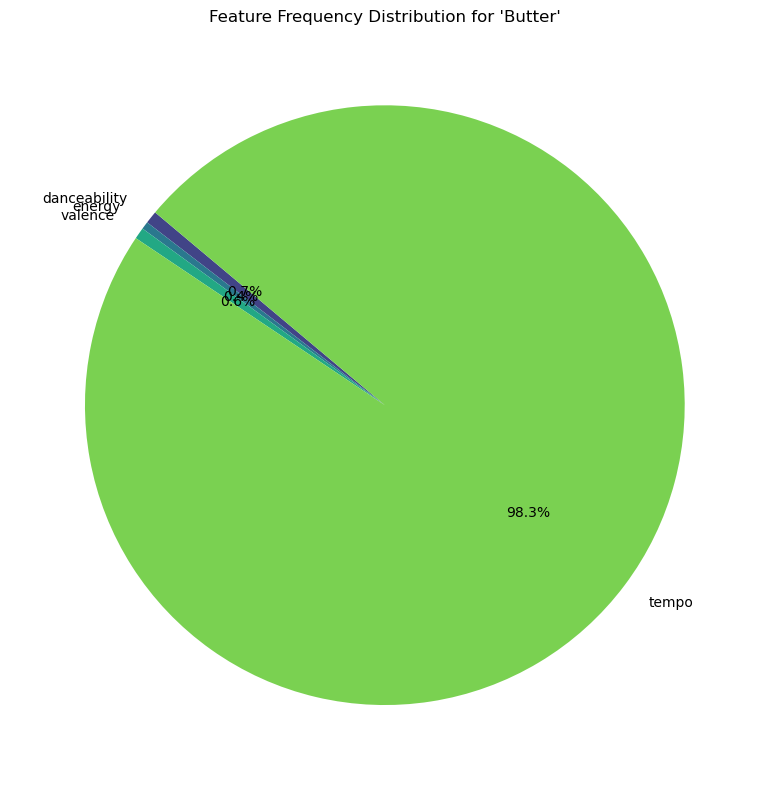

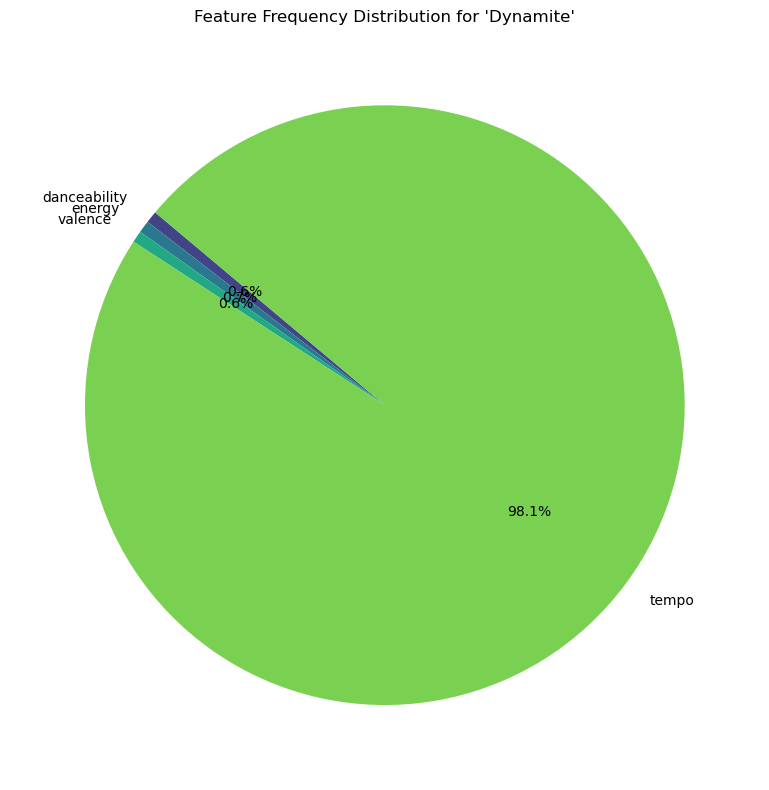

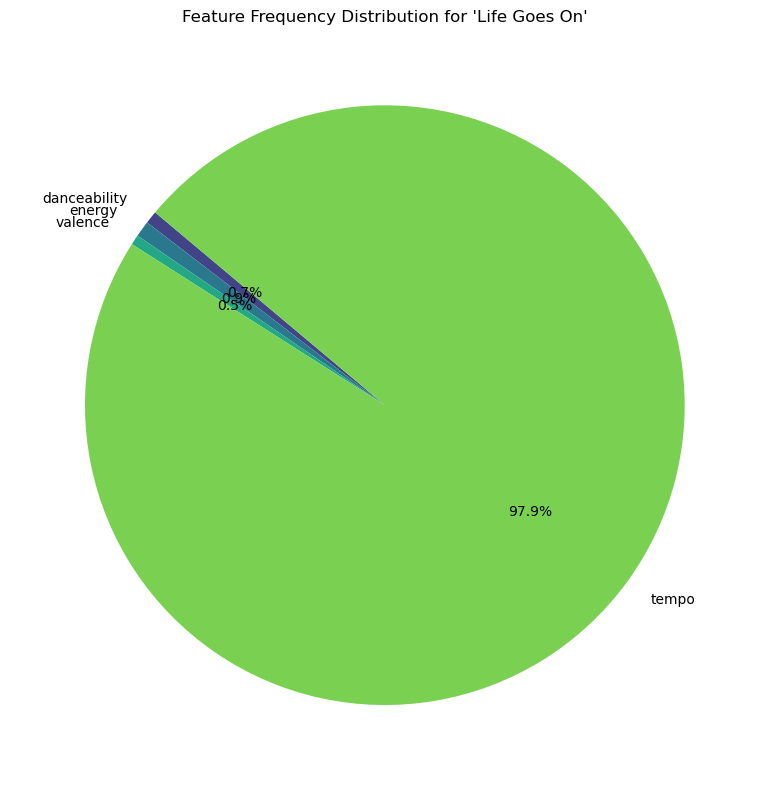

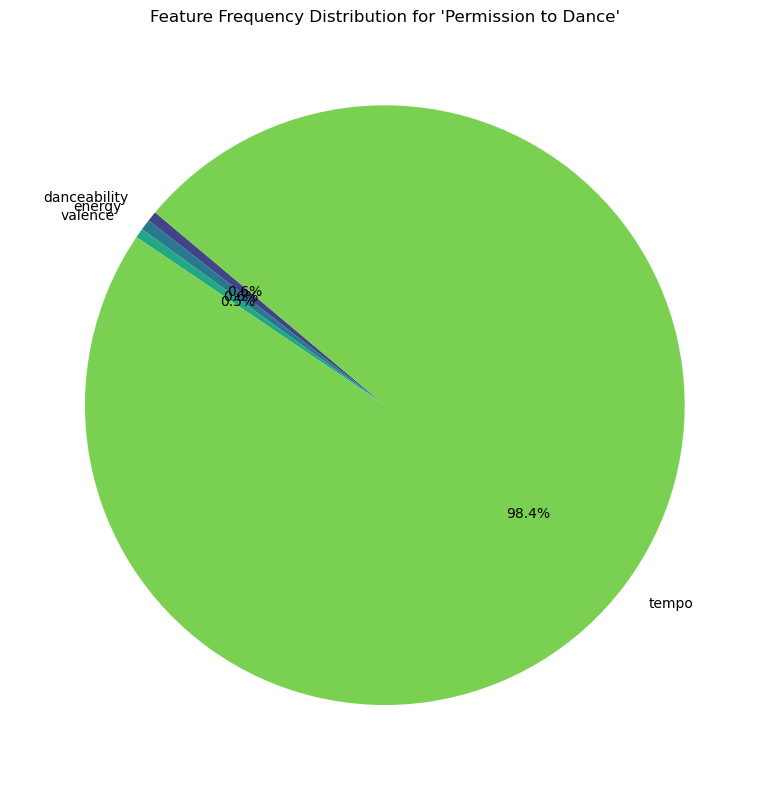

In [144]:
# Step 1: Normalize feature values for frequency per song
feature_frequencies = top_tracks_features.groupby('name')[audio_features].mean()
feature_frequencies = feature_frequencies.div(feature_frequencies.sum(axis=1), axis=0) * 100

# Step 2: Stacked bar chart for feature frequency per song
plt.figure(figsize=(12, 8))
feature_frequencies.plot(
    kind='bar',
    stacked=True,
    figsize=(12, 8),
    colormap='viridis',
    edgecolor='black'
)
plt.title("Feature Frequency Percentage for Each BTS Song")
plt.xlabel("Track Name")
plt.ylabel("Frequency Percentage")
plt.xticks(rotation=45, ha='right')
plt.legend(title="Audio Features", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Step 3: Pie charts for each song's feature frequencies
for track in feature_frequencies.index:
    plt.figure(figsize=(8, 8))
    plt.pie(
        feature_frequencies.loc[track],
        labels=feature_frequencies.columns,
        autopct='%1.1f%%',
        startangle=140,
        colors=sns.color_palette('viridis', len(feature_frequencies.columns))
    )
    plt.title(f"Feature Frequency Distribution for '{track}'")
    plt.tight_layout()
    plt.show()


# General Analysis

In [ ]:
# Merge datasets to analyze album types
album_performance = (
    df_tracks
    .merge(df_chart_positions, on='track_id')
    .groupby('album_type')
    .agg(
        avg_chart_position=('list_position', 'mean'),
        track_count=('track_id', 'count')
    )
    .sort_values(by='avg_chart_position')
)

print(album_performance)

# Visualize
sns.barplot(x=album_performance.index, y=album_performance['avg_chart_position'])
plt.title("Average Chart Position by Album Type")
plt.xlabel("Album Type")
plt.ylabel("Average Chart Position")
plt.xticks(rotation=45)
plt.show()


# Explicit performance

In [ ]:
# Merge datasets
explicit_performance = (
    df_tracks
    .merge(df_chart_positions, on='track_id')
    .groupby('explicit')
    .agg(
        avg_chart_position=('list_position', 'mean'),
        track_count=('track_id', 'count')
    )
)

print(explicit_performance)

# Visualize
explicit_performance.plot(kind='bar', y='avg_chart_position', legend=False)
plt.title("Chart Performance by Explicit Content")
plt.xlabel("Explicit")
plt.ylabel("Average Chart Position")
plt.xticks([0, 1], ['Non-Explicit', 'Explicit'], rotation=0)
plt.show()


In [ ]:
# Analyze tempo and popularity
tempo_popularity = (
    df_audio_features
    .merge(df_chart_positions, on='track_id')
)

# Correlation analysis
correlation = tempo_popularity[['tempo', 'list_position']].corr()
print(correlation)

# Scatter plot
sns.scatterplot(data=tempo_popularity, x='tempo', y='list_position')
plt.title("Tempo vs. Chart Position")
plt.xlabel("Tempo")
plt.ylabel("Chart Position")
plt.show()


In [ ]:
df.merge

In [ ]:
import pandas as pd

# Assuming df_tracks is the DataFrame with track details

# Step 1: Get the artist_id for BTS
bts_artist = df_artists.loc[df_artists['name'] == 'BTS']
bts_id = bts_artist['artist_id'].iloc[0]

# Step 2: Get all tracks by BTS
bts_tracks_mapping = df_tracks_artists_mapping.loc[df_tracks_artists_mapping['artist_id'] == bts_id]
bts_track_ids = bts_tracks_mapping['track_id'].unique()

# Step 3: Filter tracks data for BTS
bts_tracks = df_tracks.loc[df_tracks['track_id'].isin(bts_track_ids)]

# Step 4: Extract the earliest release year
# Ensure release_date is in datetime format
bts_tracks['release_date'] = pd.to_datetime(bts_tracks['release_date'], errors='coerce')
bts_tracks['release_year'] = bts_tracks['release_date'].dt.year

# Find the earliest release year
earliest_year = bts_tracks['release_year'].min()

print(f"BTS first entered Spotify in the year {earliest_year}.")


In [ ]:
# 1. Artist Dominance
# Merge artists with track-to-artist mapping and chart positions
df_artist_dominance = (df_tracks_artists_mapping
                       .merge(df_artists, on='artist_id')
                       .merge(df_chart_positions, on='track_id'))
# Group by artist and calculate average chart position and popularity
artist_dominance = (df_artist_dominance
                    .groupby(['artist_id', 'name'])
                    .agg(avg_chart_position=('list_position', 'mean'),
                         avg_popularity=('popularity', 'mean'),
                         followers=('followers', 'mean'))
                    .reset_index())

artist_dominance

In [ ]:
# Merge tracks with chart positions
df_album_genre = df_tracks.merge(df_chart_positions, on='track_id')
# Group by album type and calculate average chart position and track counts
album_genre_trends = (df_album_genre.groupby('album_type').agg(avg_chart_position=('list_position', 'mean'), track_count=('track_id', 'count')).reset_index())
album_genre_trends

In [ ]:
# 3. Audio Evolution
# Merge tracks with audio features
df_audio_evolution = df_tracks.merge(df_audio_features, on='track_id')
df_audio_evolution['release_year'] = pd.to_datetime(df_audio_evolution['release_date']).dt.year
# Group by release year and calculate average audio features
audio_evolution = (df_audio_evolution
                   .groupby('release_year')
                   .agg(danceability=('danceability', 'mean'),
                        energy=('energy', 'mean'),
                        valence=('valence', 'mean'),
                        tempo=('tempo', 'mean'))
                   .reset_index())
df_audio_evolution

In [ ]:
# 4. Explicit Content Impact
# Merge tracks with chart positions
df_explicit_impact = df_tracks.merge(df_chart_positions, on='track_id')
# Group by explicit content and calculate average chart position
explicit_content_impact = (df_explicit_impact
                           .groupby('explicit')
                           .agg(avg_chart_position=('list_position', 'mean'),
                                track_count=('track_id', 'count'))
                           .reset_index())

In [142]:
# 5. Tempo-Popularity Link
# Merge audio features with chart positions
df_tempo_popularity = df_audio_features.merge(df_chart_positions, on='track_id')
# Calculate correlation between tempo and chart position
tempo_correlation = df_tempo_popularity[['tempo', 'list_position']].corr()
tempo_correlation

,tempo,list_position
tempo,1.00000,0.00665
list_position,0.00665,1.00000


Summary of Insights to Derive
Artist Dominance: Identify which artists consistently perform well on charts.
Album/Genre Trends: Understand which album types (e.g., singles, albums) perform better.
Audio Evolution: Observe how characteristics of popular music have evolved over time.
Explicit Content Impact: Determine the role of explicit content in chart success.
Tempo-Popularity Link: Assess whether higher/lower tempo influences popularity.